# Improving beat tracking algorithms with recurrent neural network

## Introduction

Finding the beats in a piece of music is an inherently human task. When listening to a song, by instinct, we can tap our foot or nod our head on the rhythm without having to think too much about it. However, for a computer, deciding when exactly is the right time to tap is a highly non-trivial task.

Many algorithms already exist for this, with varying degrees of success. They usually begin by estimating the *onsets* of the audio sample, i.e. the times at which a note is most likely to start. Then, they produce a beat track that best fits those onsets (a [popular algorithm](http://www.ee.columbia.edu/~dpwe/resources/matlab/beat_simple/) for this step uses dynamic programming). A good implementation of this strategy is found in the [LibROSA](https://librosa.github.io/librosa/) package, as we will demonstrate below.

The problem with this approach is that in many music genres, such as jazz, many of the most accentuated onsets are *not* on the beats. This fools the algorithm, which then produces all sorts of undesirable results.

For example, let's see how it does on a small excerpt of a classic song by jazz pianist Keith Jarrett (Bye Bye Blackbird).

In [1]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import IPython.display
from PIL import Image
import torch

import beatfinder     # This project
sr = beatfinder.constants.sr
hl = beatfinder.constants.hl

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
totensor = beatfinder.model.ToTensor(device)
print(f'Device: {device}')

Device: cuda


Let's listen to the excerpt:

In [2]:
offset = 9.4
duration = 10
wav, _ = librosa.load('./data/raw-datasets/SELFMADE/audio/song1.m4a', 
                      offset=offset, duration=duration, sr=sr)
IPython.display.Audio(wav, rate=sr)

To predict where the beats are, `librosa` first estimates where the notes begin (the onsets) and then fits a beat track on those onsets, as shown below:

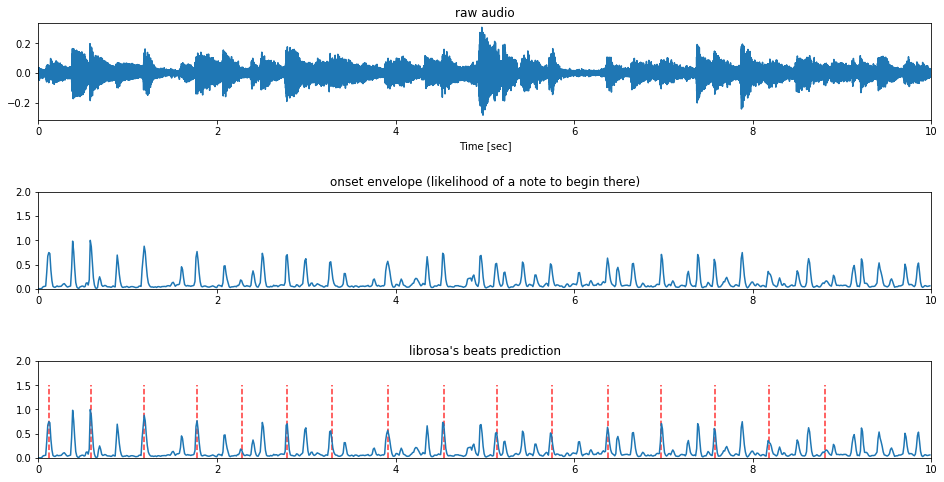

In [4]:
onset_env = librosa.onset.onset_strength(wav, sr=sr, hop_length=hl)[1:]
times = librosa.frames_to_time(np.arange(len(onset_env)), sr, hl)
onset_env -= onset_env.min()
onset_env /= onset_env.max()
bpm, librosa_beats = librosa.beat.beat_track(onset_envelope=onset_env, sr=sr, hop_length=hl, units='time') 

fig, axes = plt.subplots(3, 1)
fig.set_size_inches(16, 8)
fig.subplots_adjust(hspace=0.75)

axes[0].set_title('raw audio')
axes[0].plot(librosa.samples_to_time(np.arange(len(wav)), sr), wav)
axes[0].set_xlim(0, 10)
axes[0].set_xlabel('Time [sec]')

axes[1].set_title('onset envelope (likelihood of a note to begin there)')
axes[1].plot(times, onset_env)
axes[1].set_xlim(0, 10)
axes[1].set_ylim(0, 2)

axes[2].set_title('librosa\'s beats prediction')
axes[2].plot(times, onset_env)
axes[2].vlines(librosa_beats, 0, 1.5, color='r', alpha=0.8, linestyles='--')
axes[2].set_xlim(0, 10)
axes[2].set_ylim(0, 2);

Let's compare with the ground truth beats:

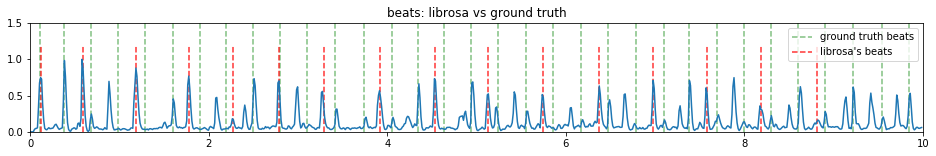

In [5]:
gt = np.loadtxt('./data/raw-datasets/SELFMADE/beats/song1_excerpt.beats')
ground_truth_beats = gt[(offset < gt) & (gt < offset + duration)] - offset

plt.figure(figsize=(16, 2))
plt.title('beats: librosa vs ground truth')
plt.plot(times, onset_env)
plt.vlines(ground_truth_beats, 0, 1.5, color='g', alpha=0.5, linestyles='--', label='ground truth beats')
plt.vlines(librosa_beats, 0, 1.2, color='r', alpha=0.8, linestyles='--', label='librosa\'s beats')
plt.xlim(0, 10)
plt.ylim(0, 1.5)
plt.legend();

Okay, it got about two beats right (1st and 6th). The problem is that (as is common in jazz) the most emphasised notes are more often not on the beats. Let's listen to the two:

In [6]:
# Librosa's prediction
clicks_lb = librosa.clicks(librosa_beats, sr=sr, hop_length=hl, length=len(wav))
IPython.display.Audio(wav + clicks_lb * 0.3, rate=sr)

In [7]:
# Ground truth
clicks_gt = librosa.clicks(ground_truth_beats, sr=sr, hop_length=hl, length=len(wav))
IPython.display.Audio(wav + clicks_gt * 0.3, rate=sr)

The goal of this project is to explore the use of deep learning to improve this scheme. Rather than computing the beat track on the full onset envelope, we train a neural network to select only the onsets that are most likely to be beats.

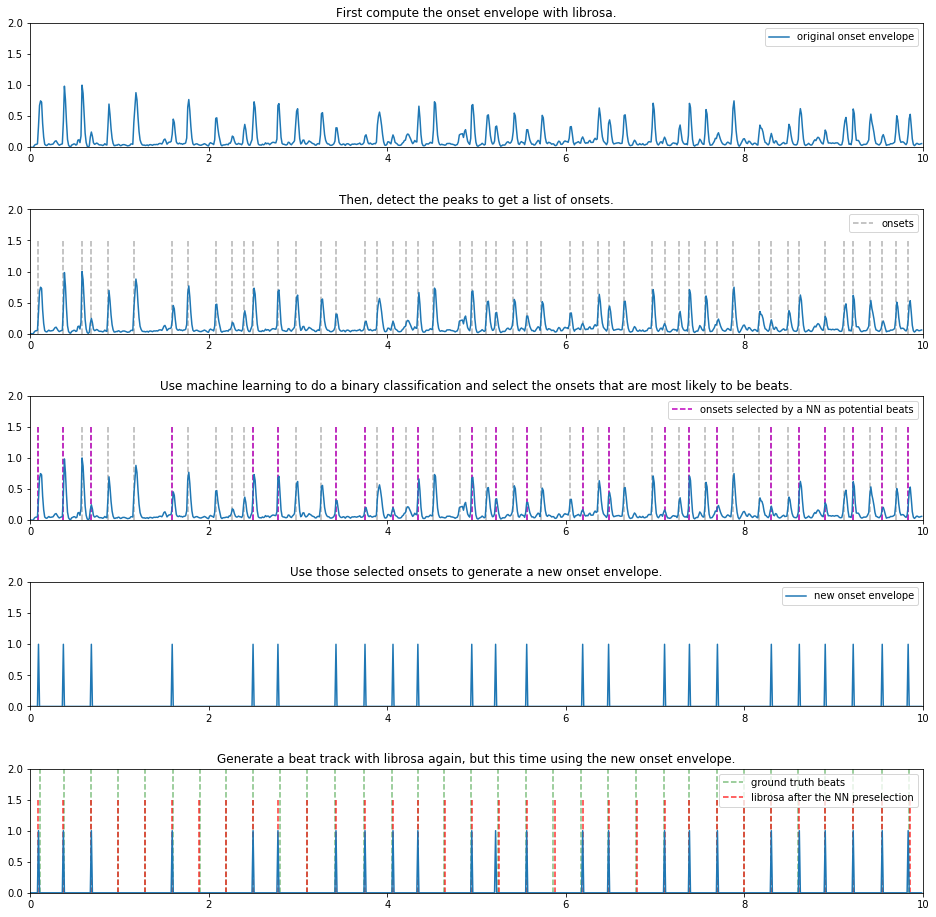

In [8]:
onsets = librosa.onset.onset_detect(onset_envelope=onset_env, sr=sr, hop_length=hl)
onsets_times = librosa.frames_to_time(onsets, sr, hl)
idxs = beatfinder.utils.select_onsets(onsets_times, ground_truth_beats)
beats_predicted, _ = beatfinder.utils.beat_track(onsets[idxs])

fig = plt.figure(figsize=(16, 16))
fig.subplots_adjust(hspace=0.5)

plt.subplot(5, 1, 1)
plt.title('First compute the onset envelope with librosa.')
plt.plot(times, onset_env, label='original onset envelope')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

plt.subplot(5, 1, 2)
plt.title('Then, detect the peaks to get a list of onsets.')
plt.plot(times, onset_env)
plt.vlines(onsets_times, 0, 1.5, color='k', alpha=0.3, linestyles='--', label='onsets')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

plt.subplot(5, 1, 3)
plt.title('Use machine learning to do a binary classification and select the onsets that are most likely to be beats.')
plt.plot(times, onset_env)
plt.vlines(onsets_times, 0, 1.5, color='k', alpha=0.3, linestyles='--')
plt.vlines(onsets_times[idxs], 0, 1.5, color='m', alpha=1, linestyles='--', label='onsets selected by a NN as potential beats')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

plt.subplot(5, 1, 4)
plt.title('Use those selected onsets to generate a new onset envelope.')
new_onset_env = np.zeros_like(onset_env)
new_onset_env[onsets[idxs]] = 1
plt.plot(times, new_onset_env, label='new onset envelope')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

plt.subplot(5, 1, 5)
plt.title('Generate a beat track with librosa again, but this time using the new onset envelope.')
plt.plot(times, new_onset_env)
plt.vlines(ground_truth_beats, 0, 2, color='g', alpha=0.5, linestyles='--', label='ground truth beats')
plt.vlines(beats_predicted, 0, 1.5, color='r', alpha=0.8, linestyles='--', label='librosa after the NN preselection')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

This new prediction is much closer to the ground truth. In fact, most humans would not make the difference; this would count as a correct answer.

So we now have formulated our problem:

> *Given a music excerpt and a list of onsets, use machine learning to select which of those onsets are more likely to be beats.*

## Representation

The first thing is to find a good representation of music. The most natural thing is to use spectrograms:

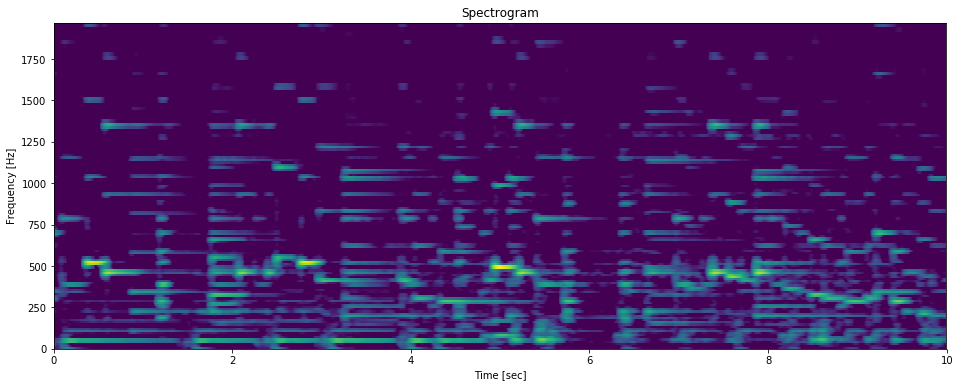

In [10]:
n_mels = 256
fmax = 2**14
n_fft = 2**12
spec = librosa.feature.melspectrogram(wav, sr, hop_length=hl, n_mels=n_mels, fmax=fmax, n_fft=n_fft)**2
spec = librosa.power_to_db(spec)
time = librosa.frames_to_time(np.arange(spec.shape[1]), sr, hl)
freq = librosa.mel_frequencies(n_mels=n_mels)[:n_mels//2]
plt.figure(figsize=(16, 6))
plt.pcolormesh(time, freq, spec[:n_mels//2, :])
plt.xlabel('Time [sec]')
plt.ylabel('Frequency [Hz]')
plt.title('Spectrogram');

Spectrograms more or less correspond to how humans perceive sound. We have time on the x-axis, and frequency (pitch) on the y-axis, so that at any given instant of time we know which frequencies are heard. We can see the notes played on the piano by Keith Jarrett at around 500 Hz, as well as Gary Peacock's bass on the bottom.

Since this is an image, we can feed it into a usual 2d convolutional stack. But I didn't get good results with that. Perhaps it has to do with the fact that spotting animal faces in spectrograms is not so useful after all.


![](./pictures/dream-spec-1.jpeg)

(Image generated with https://github.com/L1aoXingyu/Deep-Dream.)

More seriously, an audio signal is inherently a time series, and hence we get better results by treating it that way. So we will view spectrograms as sequences of intensity/frequency curves rather than 2d images and use recurrent neural networks. 

In [11]:
fig, ax = plt.subplots()
fig.set_size_inches(16, 4)
ax.axis([0, freq[-1], spec.min(), spec.max()])
ax.set_title('Spectrogram as a sequence of intensity/frequency curves')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Intensity [Db]')
line, = ax.plot([], [])
line.set_color('g')

def init():
    line.set_data([], [])
    return line,

def animate(i):
    line.set_data(freq, spec[:n_mels//2, 2 * i])
    return line,

anim = animation.FuncAnimation(fig, 
                               animate, 
                               init_func=init, 
                               frames=spec.shape[1] // 2, 
                               interval=2 * 1000 * hl / sr, 
                               blit=True);
plt.close(fig)
IPython.display.HTML(anim.to_jshtml())

## The model

We use a recurrent neural network to do a binary classification selecting which onsets are beats. At each call, it receives a spectrogram viewed as a sequence of intensity/frequency curves and outputs a sequence of probabilities. The loss is binary cross entropy on the elements of the sequence where an onset has been detected (with `librosa`), and the target data is saying which of those onsets are beats. In other words, each element in the output sequence is the probability of being a beat given that it is an onset. 

Here is the flowchart:

<img src="./pictures/flowchart.jpg" alt="Drawing" style="width: 600px;"/>

The model has been implemented in PyTorch and consists of 3 bidirectional LSTM cells followed by a fully connected layer with two outputs:

In [12]:
model = beatfinder.model.BeatFinder()
print(model)

BeatFinder(
  (lstm): LSTM(256, 256, num_layers=3, batch_first=True, dropout=0.2, bidirectional=True)
  (hid_to_beat): Linear(in_features=512, out_features=2, bias=True)
  (loss_function): NLLLoss()
)


## Datasets

I used three different datasets to train the model: [BALLROOM](https://github.com/CPJKU/BallroomAnnotations), [GTZAN](http://anasynth.ircam.fr/home/media/GTZAN-rhythm), and [HAINSWORTH](http://www.marsyas.info/tempo/). Once they are downloaded, this package contains python scripts to put them in a common format. Each dataset consists of audio files of short musical excerpts (~30-60 seconds) and text files listing the beats in seconds.

This kind of data is not trivial to work with. There are several things we want:

* To make mini-batches, we want all data samples to be of the same length, although the audio files are of different lengths. 
* We want to be able to do data augmentation by slowing and speeding the audio. 
* Computing the spectrograms takes a very long, so we want to precompute and save them.

I implemented a convenient data structure that does all this in the `beatfinder.data` module. Each sample in the dataset is an instance of a class called `AudioBeats`. This class doesn't store any data itself but points to the right files. Its main attributes are:

* `self.audio_file`: The name of an audio file (e.g. `./something.wav`).
* `self.offset`: The starting point in seconds of the sample in the audio file (e.g. start at 9.4 seconds).
* `self.duration`: The duration of the sample (e.g. 10 seconds).
* `self.stretch`: The amount by which to stretch the audio file for data augmentation (e.g. `1` for no stretching, or `2` for twice slower).
* `self.beats_file`: The name of the file containing the beats in seconds.
* `self.spec_file`: Where to save the spectrogram of this sample.
* `self.onsets_file`: Where to save the list of onsets and which of those are selected as beats.

And the main methods are:

* `self.get_data`: Returns the spectrogram, the list of onsets, the list of onsets that are beats, and the list of beats.
* `self.precompute`: Compute the spectrogram, the onsets, which onsets are beats, and save this information in the files `self.spec_file` and `self.onsets_file`.

A dataset for this project is an instance of the `AudioBeatsDataset` class (in the `beatfinder.data` module) which is a PyTorch `Dataset` whose items are `AudioBeats` objects.

Such a dataset has a convenient `save` method so that we can recover it later. Let's load one of them:

In [33]:
validset = beatfinder.data.load_dataset('./data/abstract-datasets/tmp/validset.ab')
print(f'Dataset size: {len(validset)}')

Dataset size: 420


Take a random sample:

In [34]:
audiobeats = validset[np.random.randint(len(validset))]

In the `beatfinder.display` module, there are some useful methods to see the data pointed by such an `AudioBeats` object:

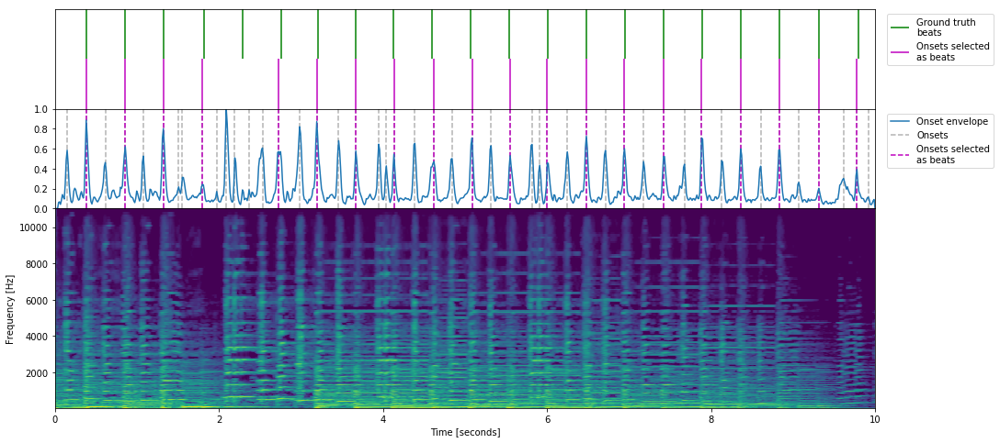

In [35]:
audiobeats.showdata(showpred=False)

On the first figure, we see the ground truth beats and the onsets that have been selected to be close enough to a beat. On the second figure, we see all onsets and the onset envelope. The third figure is the spectrogram.

## Example of prediction

Let's see how our pretrained model (which has not been trained on this dataset) does on the above sample.

In [36]:
model = beatfinder.model.BeatFinder()
model.load_state_dict(torch.load('./data/pretrained-models/model_12.pt', map_location=device))
model.to(device)
model.eval()
model.freeze()

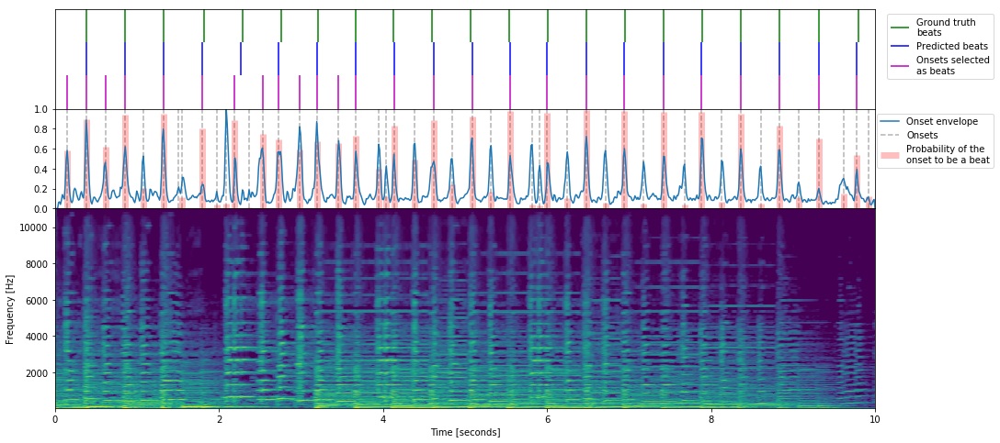

In [39]:
audiobeats.predict(model, device)
audiobeats.showdata(beatfinder=model, device=device)

That seems like close enough. A common measure is to evaluate the F-score, where two beats are considered the same if they are less than 0.07 seconds from each other:

In [40]:
predicted_beats, bpm = audiobeats.predicted_beats()
ground_truth_beats = audiobeats.get_beats()
tp, fn, fp = beatfinder.utils.tp_fn_fp(ground_truth_beats, predicted_beats)
F = beatfinder.utils.F(tp, fn, fp)
print(f'F-score: {F:.3f}')

F-score: 1.000


Note that we got a perfect score in the end, even if the model didn't get all predictions right. Some of the onsets selected as beats (the magenta bars above) are not beats, but we got enough of them right so that the dynamic programming beat tracking algorithm can take it from there and get the right result. That's the power of this method: we use deep learning to give a standard algorithm just a little push in the right direction so that it gets better results. Hence, the deep learning model itself doesn't have to be perfect to get a perfect result.

In [41]:
# (Go back to the ground truth to don't mess up with training data.)
audiobeats.precompute_onsets_and_isbeat()

## Comparison with librosa

Let's compute the F-measure that we get on the whole validation set with this model and compare it with librosa alone.

In [42]:
tp, fn, fp = beatfinder.utils.evaluate_dataset(validset, model, totensor)
F = beatfinder.utils.F(tp, fn, fp)
print(f'Model\'s F measure: {F:.4f}')

Model's F measure: 0.8349


In [44]:
tp, fn, fp = beatfinder.utils.evaluate_dataset(validset, 'librosa')
F = beatfinder.utils.F(tp, fn, fp)
print(f'Librosa\'s F measure: {F:.4f}')

Librosa's F measure: 0.6596


I think that going from 0.6596 to 0.8349 is quite an improvement.

## Train on more data

The notebook `create-data` shows how to record beats to create datasets to train a `BeatFinder` model. Let's load one of them and further train our pretrained model on it.

In [45]:
audio_file = './data/raw-datasets/SELFMADE/audio/song1.m4a'
beats_file = './data/raw-datasets/SELFMADE/beats/song1_0-160.beats'

# Validation dataset
validset = beatfinder.data.AudioBeatsDatasetFromSong(audio_file, beats_file, 
                    precomputation_path='./data/abstract-datasets/selfmade/tmp/valid/',
                    duration=10, song_offset=130, song_duration=20)
# Training dataset with no data augmentaion
trainset_norm = beatfinder.data.AudioBeatsDatasetFromSong(audio_file, beats_file, 
                    precomputation_path='./data/abstract-datasets/selfmade/tmp/norm/',
                    duration=10, song_offset=0, song_duration=130)
# Make more training datasets with data augmentation
trainsets = [trainset_norm]
for i in range(2):
    trainset_aug = beatfinder.data.AudioBeatsDatasetFromSong(audio_file, beats_file, 
                    precomputation_path=f'./data/abstract-datasets/selfmade/tmp/aug{i}/',
                    duration=10, song_offset=0, song_duration=130)
    trainset_aug.augment()
    trainsets.append(trainset_aug)
trainset = beatfinder.data.ConcatAudioBeatsDataset(trainsets)

print(f'trainset size: {len(trainset)}')
print(f'validset size: {len(validset)}')

trainset size: 39
validset size: 2


In [46]:
# Compute all spectrograms and onsets
trainset.precompute()
validset.precompute()

In [47]:
# Readjust the beats on the onsets.
trainset.correct()

See an example of the training data.

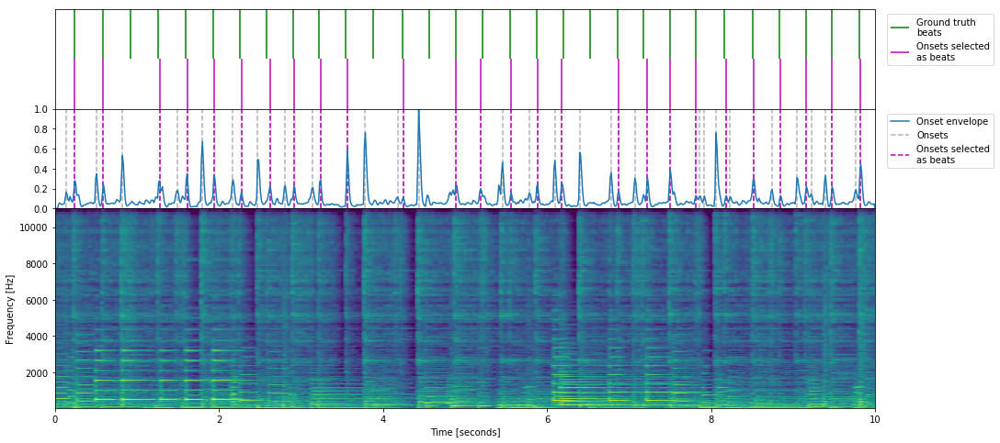

In [49]:
dataset = trainset
i = np.random.randint(len(dataset))
audiobeats = dataset[i]
audiobeats.showdata(showpred=False)

Train with a very low learning rate:

In [50]:
trainset.transform = totensor
validset.transform = totensor
model.train()
model.unfreeze()
model.set_lr(0.00005)
train_hist, valid_hist = model.fit(trainset, validset, batch_size=8, epochs=5)

| 1 | L: 0.443 0.302 | F: 0.764 0.863 | A: 0.794 0.891 | 0.42 s/b | 0:00:02 | ETA: 0:00:08 |
| 2 | L: 0.357 0.264 | F: 0.841 0.917 | A: 0.854 0.933 | 0.39 s/b | 0:00:01 | ETA: 0:00:05 |
| 3 | L: 0.299 0.253 | F: 0.860 0.907 | A: 0.872 0.924 | 0.41 s/b | 0:00:02 | ETA: 0:00:04 |
| 4 | L: 0.278 0.214 | F: 0.872 0.928 | A: 0.882 0.941 | 0.40 s/b | 0:00:02 | ETA: 0:00:02 |
| 5 | L: 0.249 0.213 | F: 0.880 0.928 | A: 0.891 0.941 | 0.40 s/b | 0:00:01 | ETA: 0:00:00 |


In [51]:
model.eval()
model.freeze()
validset.transform = None
trainset.transform = None

Let's see how the model does on the two validation samples.

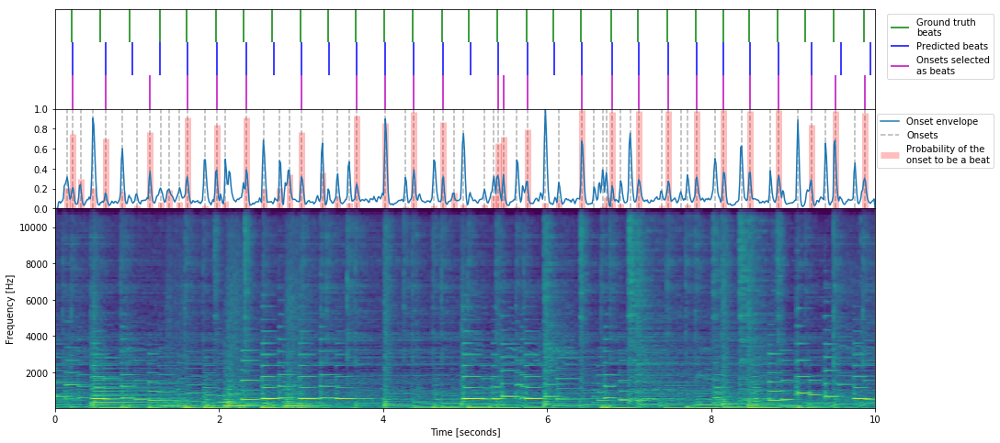

In [52]:
audiobeats = validset[0]
audiobeats.predict(model, device)
audiobeats.showdata(beatfinder=model, device=device)

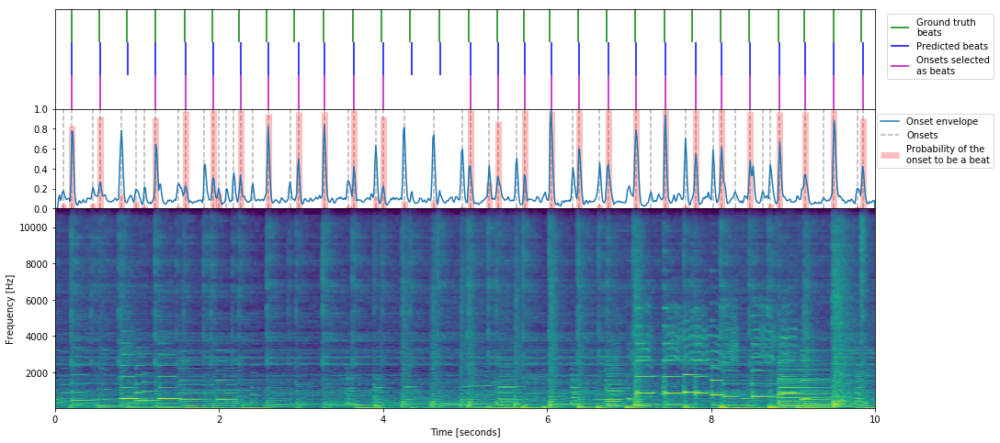

In [53]:
audiobeats = validset[1]
audiobeats.predict(model, device)
audiobeats.showdata(beatfinder=model, device=device)

Very cool. The model can find the beats on parts of the song it has never heard. Recall from the introduction that LibROSA alone was not able to do this on this type of music.